# Assignment: Real Estate Price Prediction using Decision Trees

### Dataset Description

For this assignment, you'll use the "Melbourne Housing Market" dataset, which offers a comprehensive view of the real estate market in Melbourne, Australia. The dataset includes various attributes related to property listings, aiming to predict property prices. The dataset is available on Kaggle: [Melbourne Housing Market](https://www.kaggle.com/datasets/anthonypino/melbourne-housing-market).

### Dataset Features

- `Suburb`: Suburb location
- `Address`: Address of the property
- `Rooms`: Number of rooms
- `Type`: Type of dwelling
- `Price`: Price in Australian dollars
- `Method`: Method of selling
- `SellerG`: Real Estate Agent
- `Date`: Date sold
- `Distance`: Distance from CBD
- `Regionname`: General Region (West, North West, North, North east …etc)
- `Propertycount`: Number of properties that exist in the suburb.
- `Bedroom2` : Scraped # of Bedrooms (from different source)
- `Bathroom`: Number of Bathrooms
- `Car`: Number of carspots
- `Landsize`: Land Size
- `BuildingArea`: Building Size
- `YearBuilt`: Year the house was built
- `CouncilArea`: Governing council for the area


### Assignment Objectives

1. **Data Cleaning and Preprocessing**
   - Perform data cleaning and preprocessing to prepare the dataset for modeling.
   - Explore the data to understand its characteristics and how they might affect the modeling strategy.
2. **Model Training and Evaluation**
   - Train a Decision Tree Regressor to predict property prices.
   - Evaluate the model using appropriate metrics and techniques.


#### 1. Data Cleaning
   - Check for and handle missing values appropriately.
   - Investigate and manage outliers, particularly in price, area, and other numerical features, to avoid skewing the model's predictions.


In [1]:
import opendatasets as od
import numpy as np
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt

In [2]:
od.download('https://www.kaggle.com/datasets/anthonypino/melbourne-housing-market')

Skipping, found downloaded files in ".\melbourne-housing-market" (use force=True to force download)


In [3]:
df = pd.read_csv('melbourne-housing-market/Melbourne_housing_FULL.csv')
df

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.80140,144.99580,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.79960,144.99840,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.80790,144.99340,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.81140,145.01160,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.80930,144.99440,Northern Metropolitan,4019.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,...,1.0,3.0,593.0,NaN,NaN,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,...,2.0,1.0,98.0,104.0,2018.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,...,1.0,2.0,220.0,120.0,2000.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0
34855,Yarraville,12/37 Stephen St,3,h,1140000.0,SP,hockingstuart,24/02/2018,6.3,3013.0,...,NaN,NaN,NaN,NaN,NaN,Maribyrnong City Council,NaN,NaN,Western Metropolitan,6543.0


In [4]:
pd.set_option('display.max_columns',None)
df

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,2.0,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.80140,144.99580,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,2.0,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.79960,144.99840,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,2.0,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.80790,144.99340,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,3.0,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.81140,145.01160,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,3.0,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.80930,144.99440,Northern Metropolitan,4019.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34852,Yarraville,13 Burns St,4,h,1480000.0,PI,Jas,24/02/2018,6.3,3013.0,4.0,1.0,3.0,593.0,NaN,NaN,Maribyrnong City Council,-37.81053,144.88467,Western Metropolitan,6543.0
34853,Yarraville,29A Murray St,2,h,888000.0,SP,Sweeney,24/02/2018,6.3,3013.0,2.0,2.0,1.0,98.0,104.0,2018.0,Maribyrnong City Council,-37.81551,144.88826,Western Metropolitan,6543.0
34854,Yarraville,147A Severn St,2,t,705000.0,S,Jas,24/02/2018,6.3,3013.0,2.0,1.0,2.0,220.0,120.0,2000.0,Maribyrnong City Council,-37.82286,144.87856,Western Metropolitan,6543.0
34855,Yarraville,12/37 Stephen St,3,h,1140000.0,SP,hockingstuart,24/02/2018,6.3,3013.0,NaN,NaN,NaN,NaN,NaN,NaN,Maribyrnong City Council,NaN,NaN,Western Metropolitan,6543.0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34857 entries, 0 to 34856
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Suburb         34857 non-null  object 
 1   Address        34857 non-null  object 
 2   Rooms          34857 non-null  int64  
 3   Type           34857 non-null  object 
 4   Price          27247 non-null  float64
 5   Method         34857 non-null  object 
 6   SellerG        34857 non-null  object 
 7   Date           34857 non-null  object 
 8   Distance       34856 non-null  float64
 9   Postcode       34856 non-null  float64
 10  Bedroom2       26640 non-null  float64
 11  Bathroom       26631 non-null  float64
 12  Car            26129 non-null  float64
 13  Landsize       23047 non-null  float64
 14  BuildingArea   13742 non-null  float64
 15  YearBuilt      15551 non-null  float64
 16  CouncilArea    34854 non-null  object 
 17  Lattitude      26881 non-null  float64
 18  Longti

In [6]:
df.isna().sum()

Suburb               0
Address              0
Rooms                0
Type                 0
Price             7610
Method               0
SellerG              0
Date                 0
Distance             1
Postcode             1
Bedroom2          8217
Bathroom          8226
Car               8728
Landsize         11810
BuildingArea     21115
YearBuilt        19306
CouncilArea          3
Lattitude         7976
Longtitude        7976
Regionname           3
Propertycount        3
dtype: int64

In [7]:
df.drop(['Lattitude','Longtitude','Regionname','Propertycount','Propertycount','Postcode'],axis=1, inplace=True)

In [8]:
df['Price']=df['Price'].fillna(df['Price'].mode()[0])
df['Bedroom2']=df['Bedroom2'].fillna(df['Bedroom2'].mode()[0])
df['Bathroom']=df['Bathroom'].fillna(df['Bathroom'].mode()[0])
df['Car']=df['Car'].fillna(df['Car'].mode()[0])
df['Landsize']=df['Landsize'].fillna(df['Landsize'].mode()[0])
df['BuildingArea']=df['BuildingArea'].fillna(df['BuildingArea'].mode()[0])
df['YearBuilt']=df['YearBuilt'].fillna(df['YearBuilt'].mode()[0])
df['CouncilArea']=df['CouncilArea'].fillna(df['CouncilArea'].mode()[0])
df['Distance']=df['Distance'].fillna(df['Distance'].mode()[0])

In [9]:
df.isna().sum()

Suburb          0
Address         0
Rooms           0
Type            0
Price           0
Method          0
SellerG         0
Date            0
Distance        0
Bedroom2        0
Bathroom        0
Car             0
Landsize        0
BuildingArea    0
YearBuilt       0
CouncilArea     0
dtype: int64

In [10]:
df.shape

(34857, 16)

In [11]:
df.select_dtypes(include=np.number).columns.tolist()

['Rooms',
 'Price',
 'Distance',
 'Bedroom2',
 'Bathroom',
 'Car',
 'Landsize',
 'BuildingArea',
 'YearBuilt']

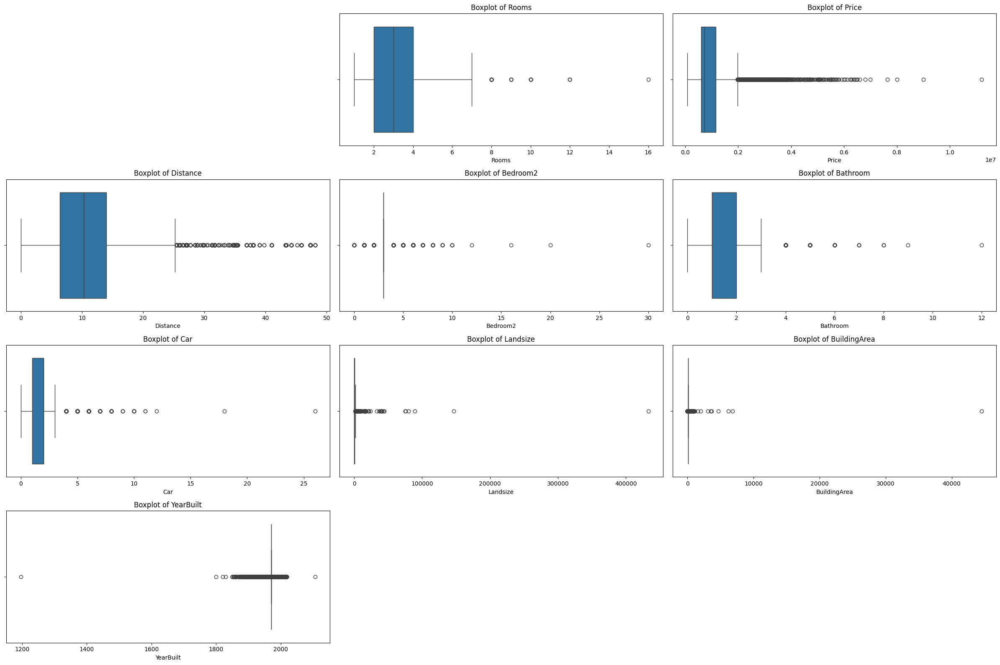

In [12]:
import seaborn as sns
numerical_features = ['Rooms','Price', 'Distance', 'Bedroom2', 'Bathroom', 'Car', 'Landsize', 'BuildingArea', 'YearBuilt']
plt.figure(figsize=(24, 16))
for i, feature in enumerate(numerical_features, 1):
    plt.subplot(4, 3, i+1)
    sns.boxplot(x=df[feature])
    plt.title(f'Boxplot of {feature}')
plt.tight_layout()
plt.show()

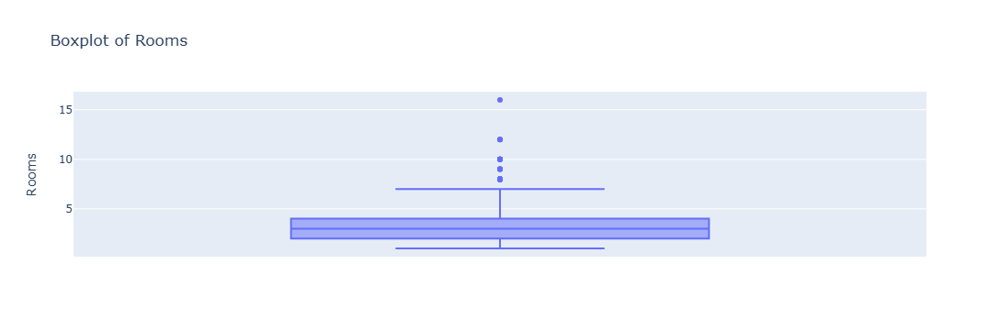

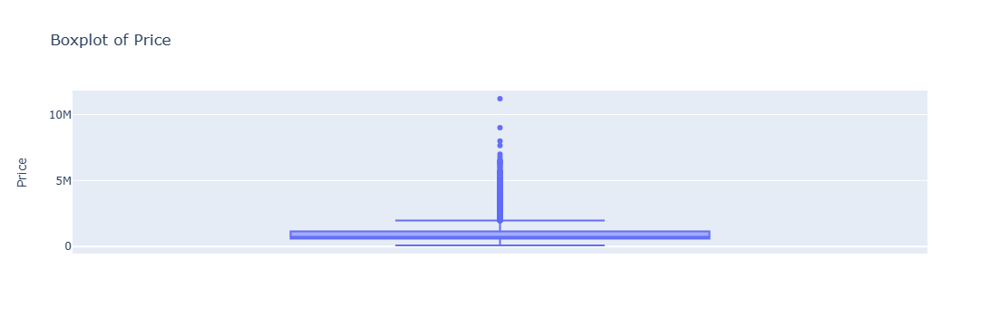

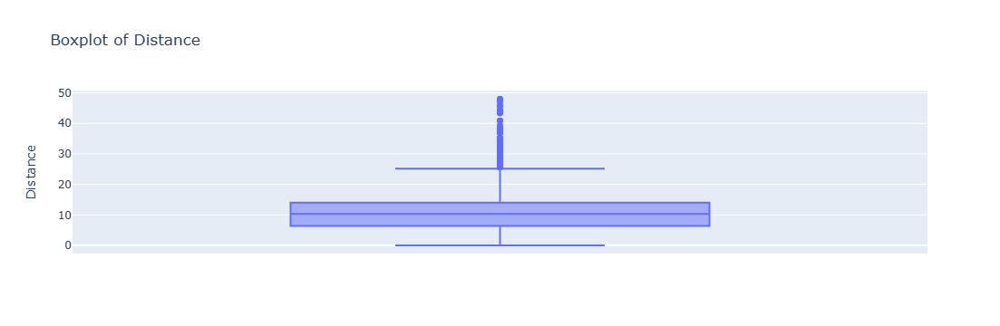

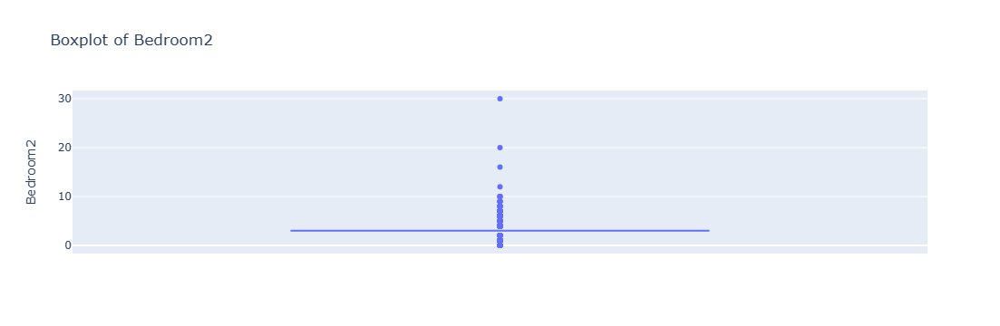

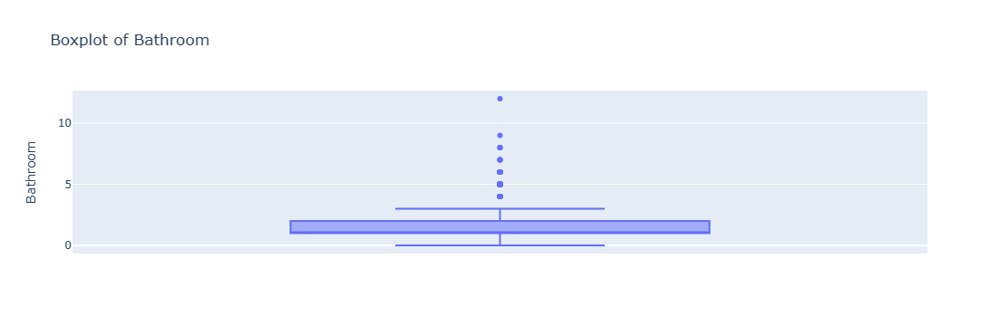

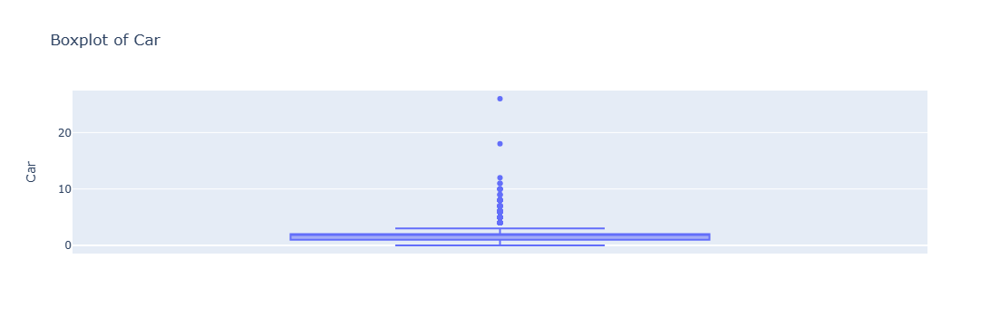

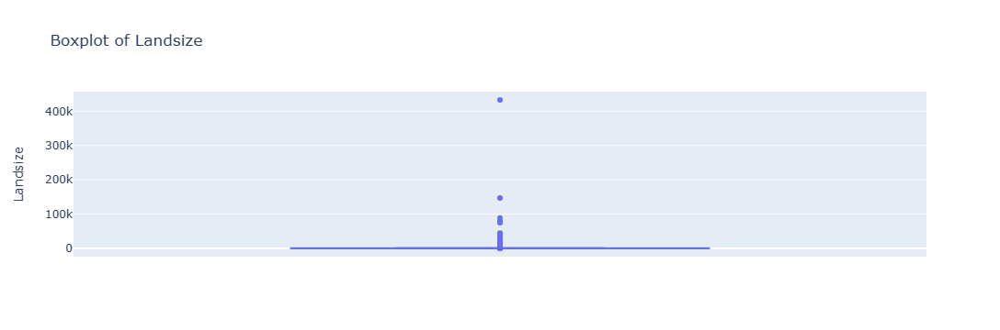

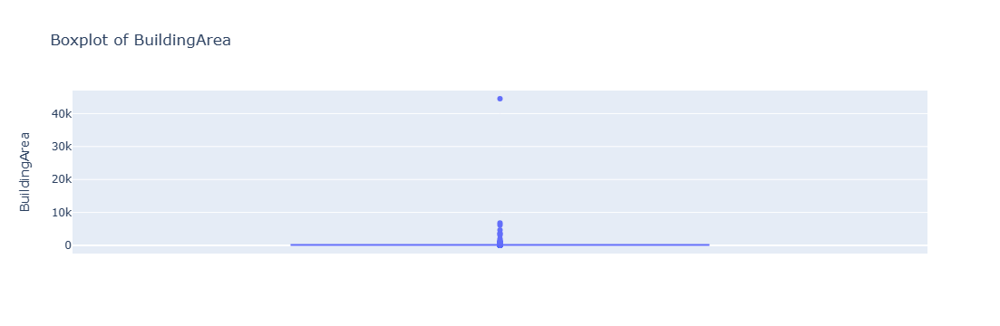

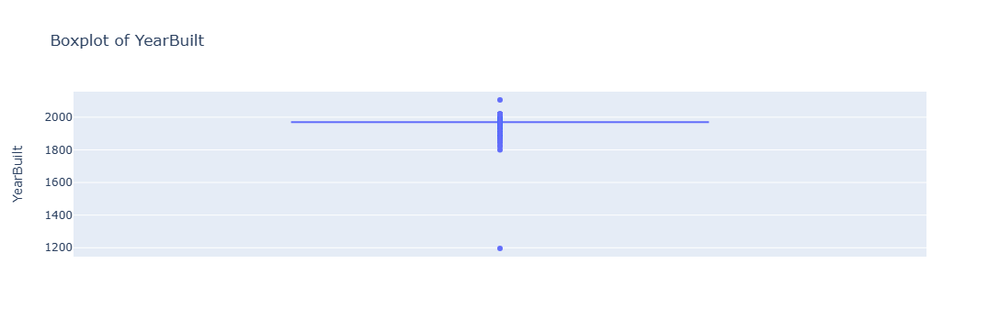

In [13]:
for feature in numerical_features:
    fig = px.box(df, y=feature, title=f'Boxplot of {feature}')
    fig.show()

#### 2. Data Preprocessing
   - Consider how to handle categorical variables, such as Suburb, Type, Method, and Regionname.
   - Discuss scaling or normalization techniques for numerical features and their necessity given the dataset's characteristics.
   - Explore potential feature engineering opportunities to improve model performance.


In [14]:
from sklearn.model_selection import train_test_split

In [15]:
train_val_df, test_df = train_test_split(df,test_size=0.2,random_state=42)

In [16]:
train_df, val_df = train_test_split(train_val_df, test_size=0.25, random_state=42)

In [17]:
input_cols = df.drop('Price',axis=1).columns
input_cols

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Method', 'SellerG', 'Date',
       'Distance', 'Bedroom2', 'Bathroom', 'Car', 'Landsize', 'BuildingArea',
       'YearBuilt', 'CouncilArea'],
      dtype='object')

In [18]:
target_cols = 'Price'
target_cols

'Price'

In [19]:
train_inputs=train_df[input_cols]
train_target= train_df[target_cols]

In [20]:
val_inputs = val_df[input_cols]
val_target = val_df[target_cols]

In [21]:
test_inputs = test_df[input_cols]
test_target = test_df[target_cols]

In [22]:
numerical = train_inputs.select_dtypes(include=np.number).columns.tolist()

print(numerical)

['Rooms', 'Distance', 'Bedroom2', 'Bathroom', 'Car', 'Landsize', 'BuildingArea', 'YearBuilt']


In [23]:
from sklearn.preprocessing import StandardScaler

In [24]:
scaler = StandardScaler()

In [25]:
scaler.fit(df[numerical])

StandardScaler()

In [26]:
train_inputs[numerical] = scaler.transform(train_inputs[numerical])
val_inputs[numerical] = scaler.transform(val_inputs[numerical])
test_inputs[numerical] = scaler.transform(test_inputs[numerical])

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\1738255583.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\1738255583.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\1738255583.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.

In [27]:
train_inputs[numerical].describe()

,Rooms,Distance,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt
count,20913.000000,20913.000000,20913.000000,20913.000000,20913.000000,20913.000000,20913.000000,20913.000000
mean,0.003127,-0.002670,-0.002615,0.000012,-0.006024,0.005798,-0.005437,-0.001188
std,1.002106,1.003806,0.988864,0.996051,1.013615,1.256385,0.328170,0.995334
min,-2.094002,-1.647581,-3.571580,-2.152470,-2.034916,-0.141287,-0.537660,-5.906097
25%,-1.062988,-0.704838,-0.075393,-0.695490,-0.902356,-0.141287,-0.062803,0.083914
50%,-0.031974,-0.130353,-0.075393,-0.695490,0.230203,-0.061010,-0.062803,0.083914
75%,0.999040,0.414670,-0.075393,0.761490,0.230203,0.073984,-0.062803,0.083914
max,13.371207,5.437725,19.736332,10.960349,27.411626,155.736967,26.335334,2.040651


In [28]:
from sklearn.preprocessing import OneHotEncoder

In [29]:
categorical = train_inputs.select_dtypes('object').columns.tolist()

In [30]:
categorical

['Suburb', 'Address', 'Type', 'Method', 'SellerG', 'Date', 'CouncilArea']

In [31]:
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore')

In [32]:
encoder.fit(df[categorical])

OneHotEncoder(handle_unknown='ignore', sparse_output=False)

In [33]:
encoded_cols = list(encoder.get_feature_names_out(categorical))
encoded_cols

['Suburb_Abbotsford',
 'Suburb_Aberfeldie',
 'Suburb_Airport West',
 'Suburb_Albanvale',
 'Suburb_Albert Park',
 'Suburb_Albion',
 'Suburb_Alphington',
 'Suburb_Altona',
 'Suburb_Altona Meadows',
 'Suburb_Altona North',
 'Suburb_Ardeer',
 'Suburb_Armadale',
 'Suburb_Ascot Vale',
 'Suburb_Ashburton',
 'Suburb_Ashwood',
 'Suburb_Aspendale',
 'Suburb_Aspendale Gardens',
 'Suburb_Attwood',
 'Suburb_Avondale Heights',
 'Suburb_Avonsleigh',
 'Suburb_Bacchus Marsh',
 'Suburb_Balaclava',
 'Suburb_Balwyn',
 'Suburb_Balwyn North',
 'Suburb_Bayswater',
 'Suburb_Bayswater North',
 'Suburb_Beaconsfield',
 'Suburb_Beaconsfield Upper',
 'Suburb_Beaumaris',
 'Suburb_Belgrave',
 'Suburb_Bellfield',
 'Suburb_Bentleigh',
 'Suburb_Bentleigh East',
 'Suburb_Berwick',
 'Suburb_Black Rock',
 'Suburb_Blackburn',
 'Suburb_Blackburn North',
 'Suburb_Blackburn South',
 'Suburb_Bonbeach',
 'Suburb_Boronia',
 'Suburb_Botanic Ridge',
 'Suburb_Box Hill',
 'Suburb_Braybrook',
 'Suburb_Briar Hill',
 'Suburb_Brighton',

In [34]:
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical])

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\332239466.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\332239466.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\332239466.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragm

In [35]:
# val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical])

In [ ]:
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical])

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\941699902.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\941699902.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

C:\Users\Bibhakar\AppData\Local\Temp\ipykernel_22704\941699902.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragm

In [ ]:
train_inputs[encoded_cols]

#### 3. Data Exploration
   - Analyze the distributions of numerical features and their relationship with the target variable, Price.
   - Examine categorical features to understand their influence on property prices.


In [46]:
categorical

['Suburb', 'Address', 'Type', 'Method', 'SellerG', 'Date', 'CouncilArea']

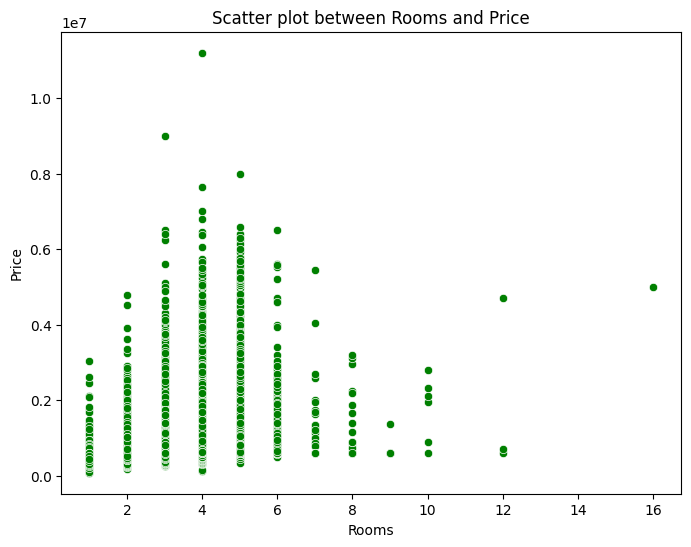

Correlation between Rooms and Price: 0.36


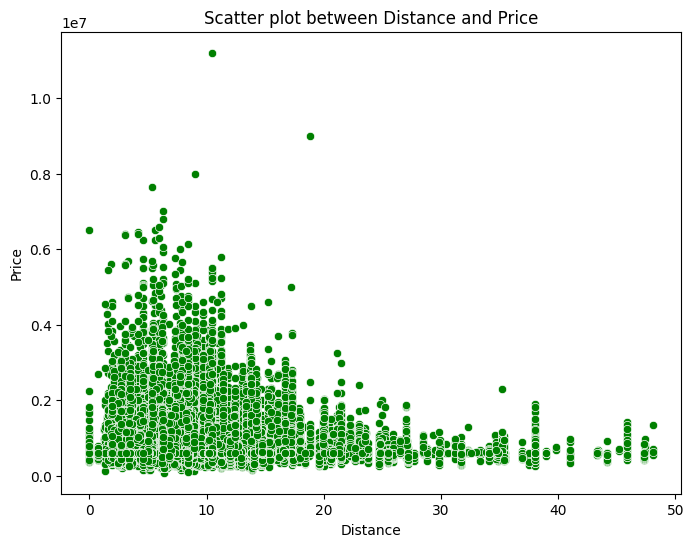

Correlation between Distance and Price: -0.17


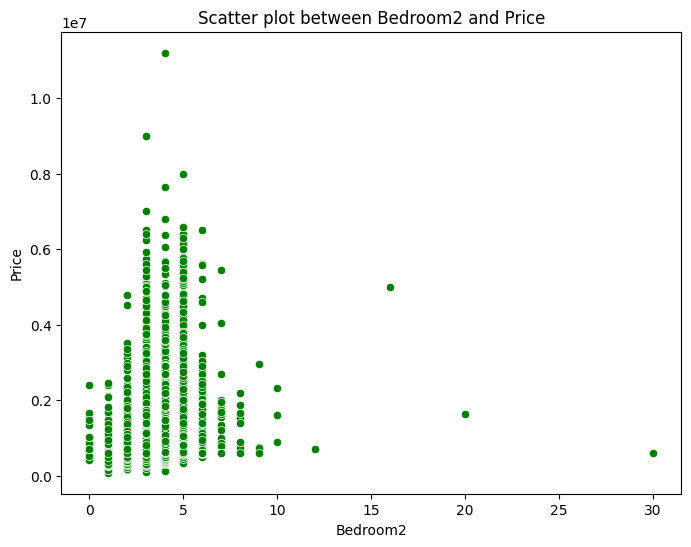

Correlation between Bedroom2 and Price: 0.29


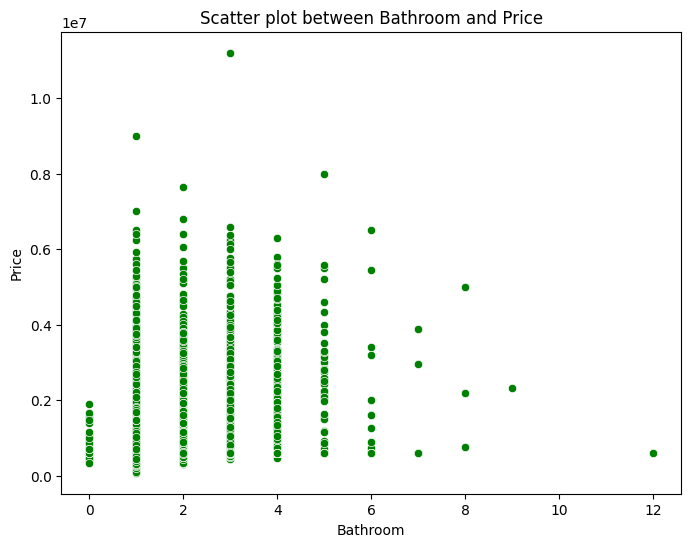

Correlation between Bathroom and Price: 0.30


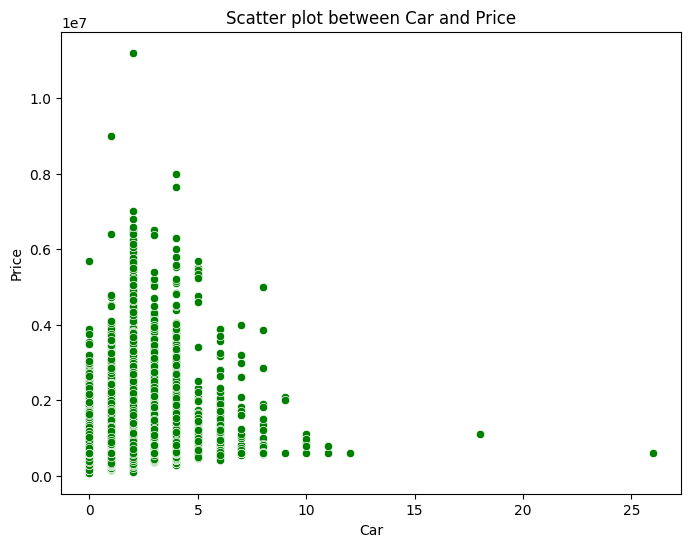

Correlation between Car and Price: 0.13


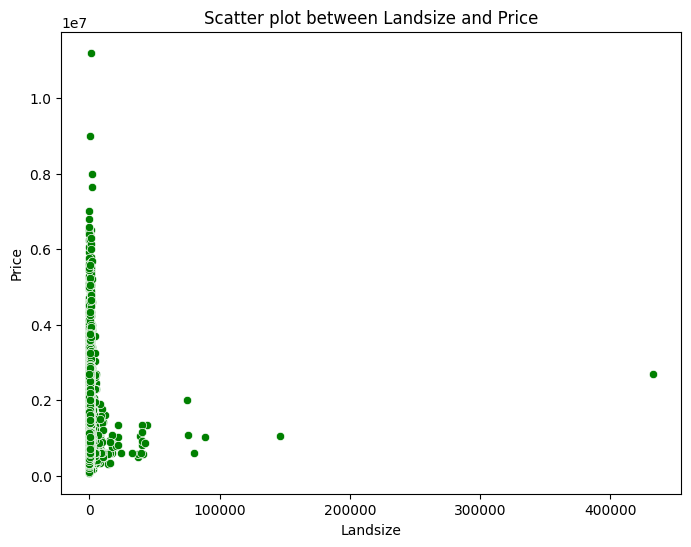

Correlation between Landsize and Price: 0.03


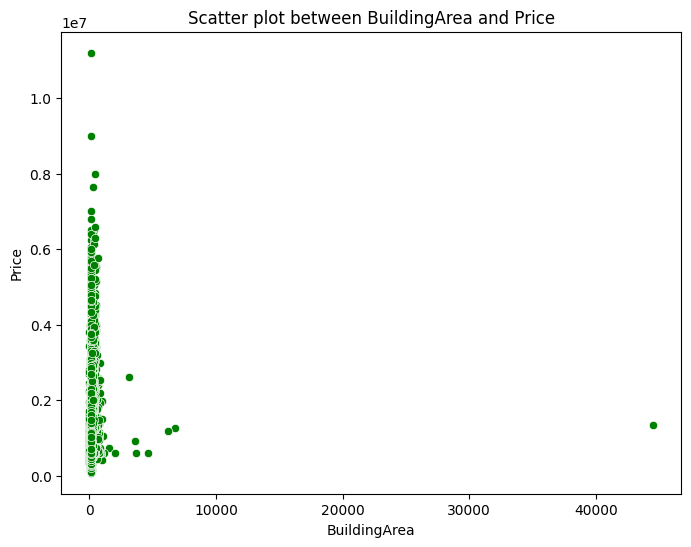

Correlation between BuildingArea and Price: 0.06


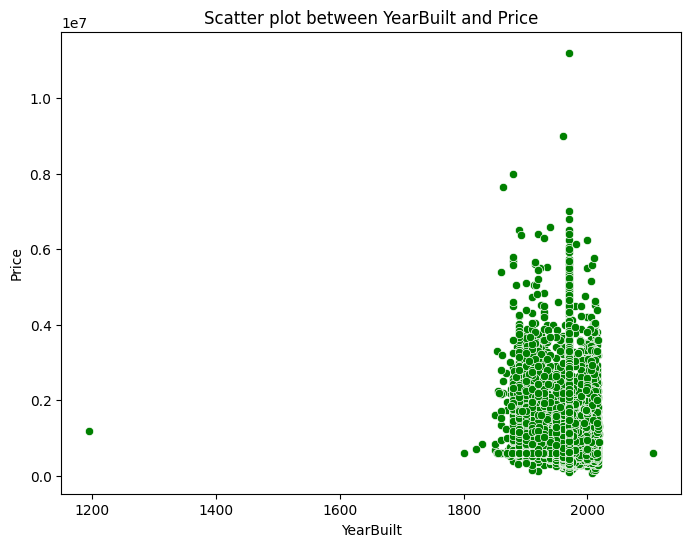

Correlation between YearBuilt and Price: -0.18


In [47]:
from scipy.stats import pearsonr
for fe in numerical:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=df, x=fe, y='Price', color='green')
    plt.title(f'Scatter plot between {fe} and Price')
    plt.xlabel(fe)
    plt.ylabel('Price')
    plt.show()
    correlation, _ = pearsonr(df[fe], df['Price'])
    print(f'Correlation between {fe} and Price: {correlation:.2f}')

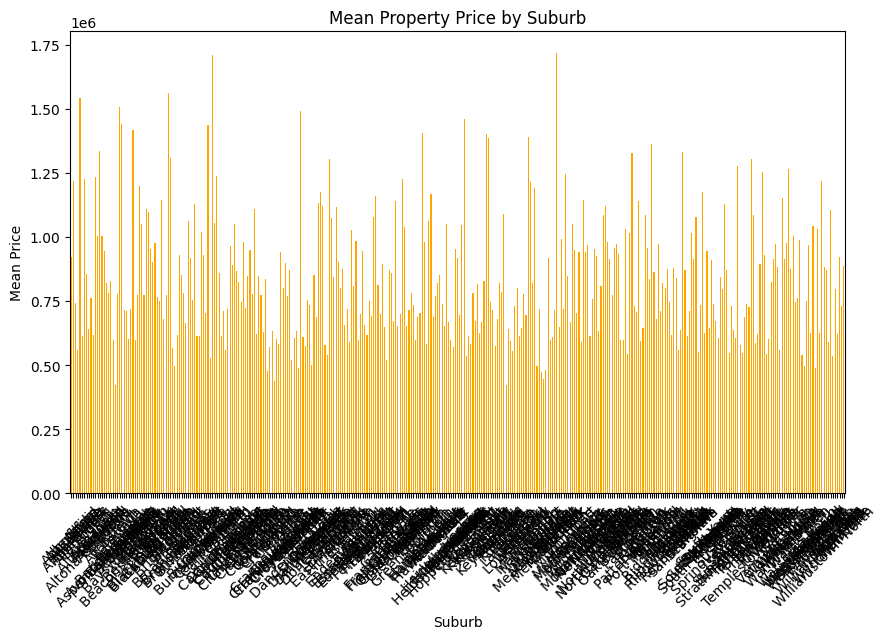

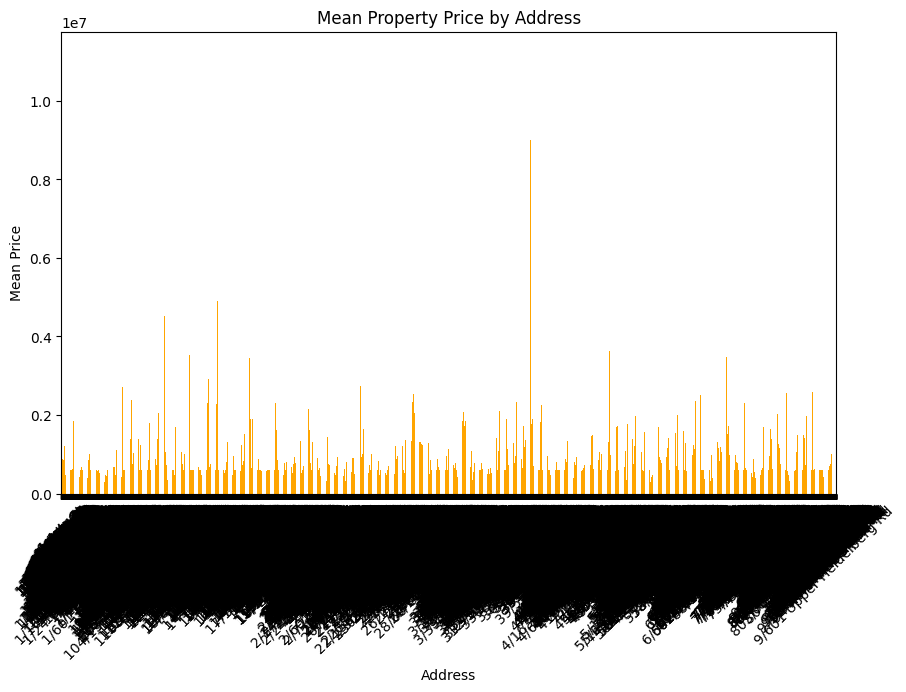

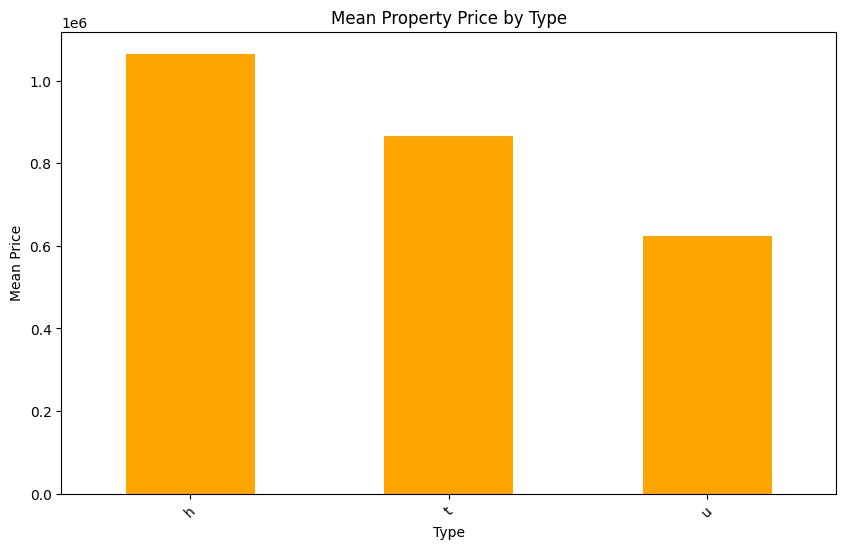

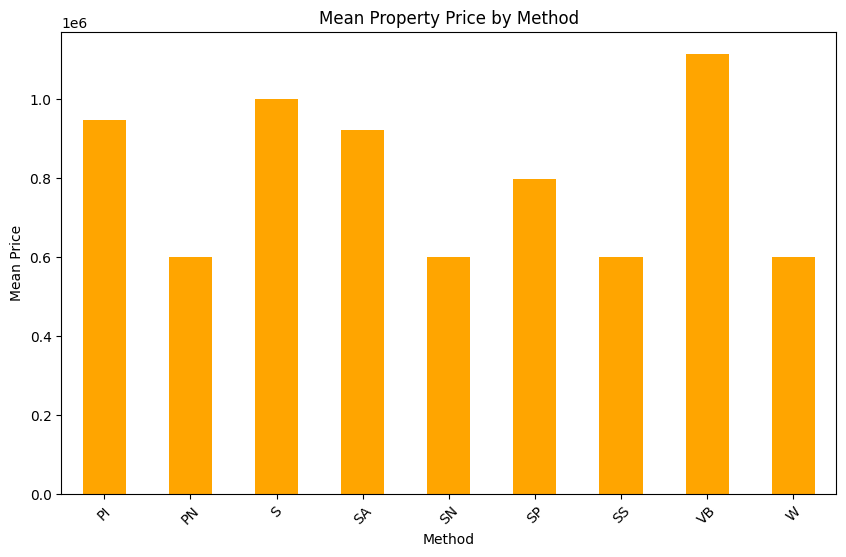

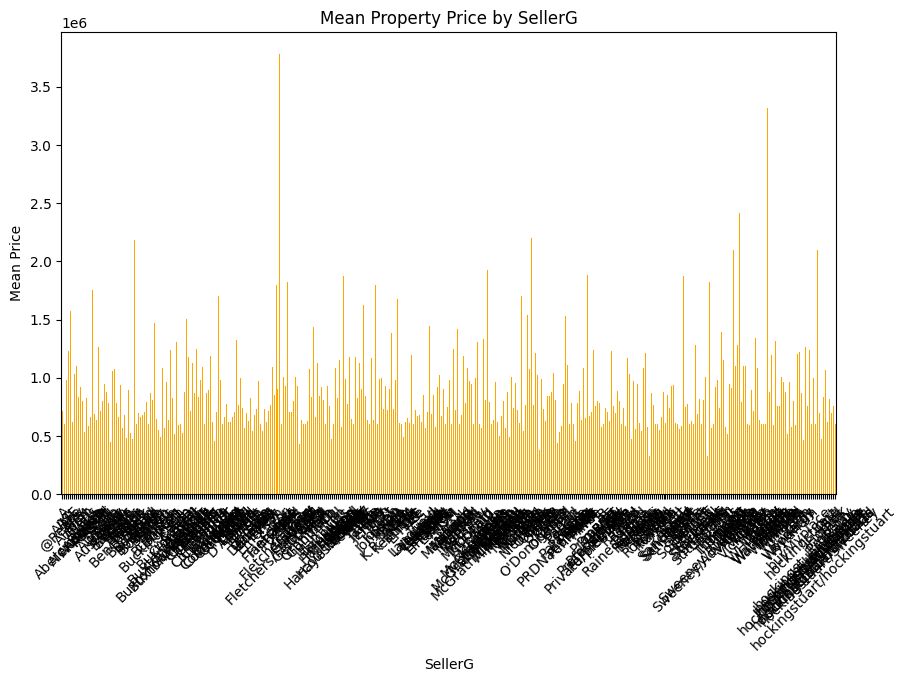

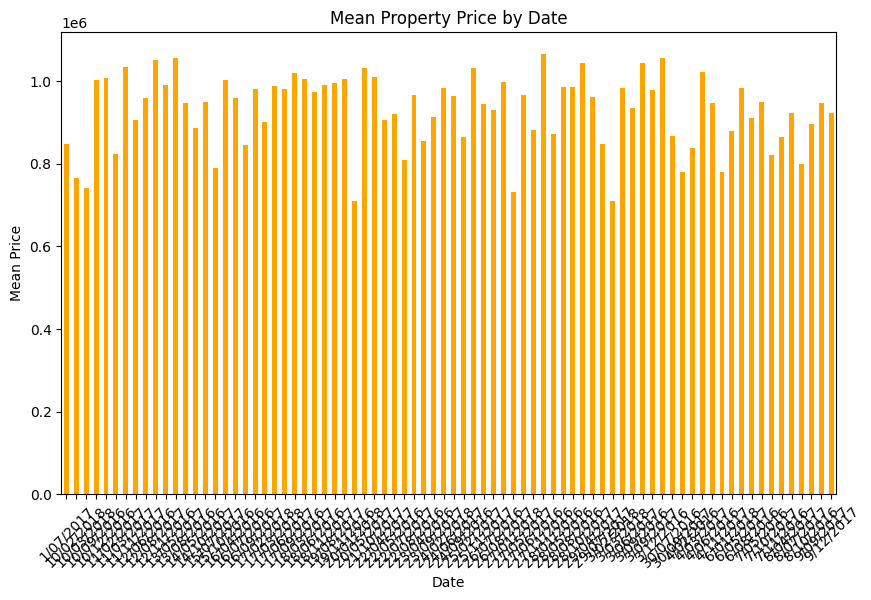

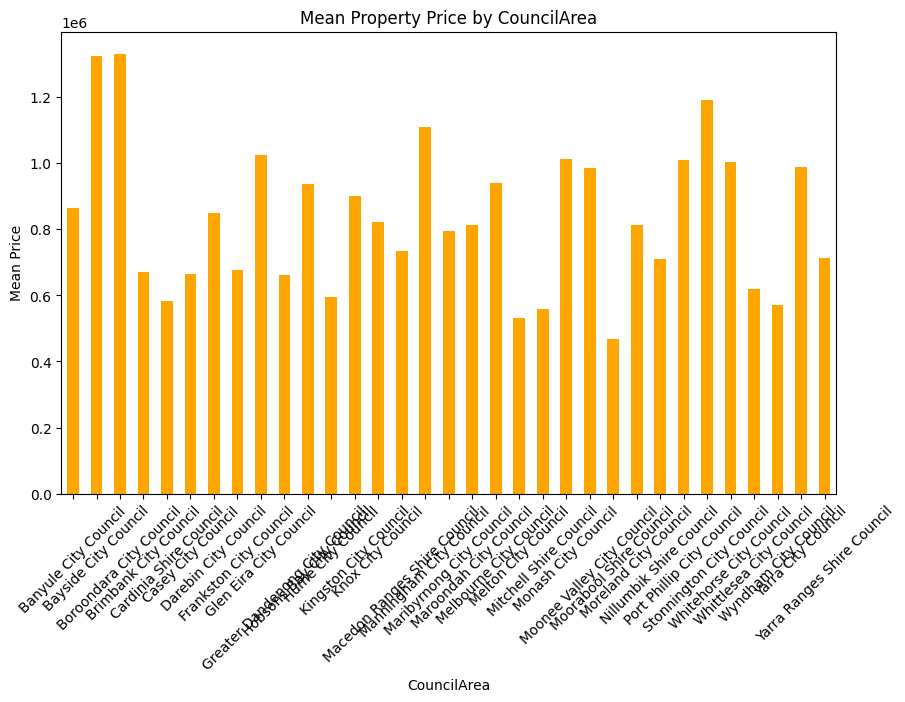

In [48]:
for fe in categorical:
    mean_price_by_region = df.groupby(fe)['Price'].mean()

    mean_price_by_region.plot(kind='bar', figsize=(10, 6), color='orange')
    plt.title(f'Mean Property Price by {fe}')
    plt.xlabel(fe)
    plt.ylabel('Mean Price')
    plt.xticks(rotation=45)
    plt.show()

#### 4. Model Training
   - Train a Decision Tree Regressor using `DecisionTreeRegressor` from `sklearn.tree`.
   - Experiment with different tree depths to find an optimal balance that avoids overfitting while maintaining good prediction accuracy.
   - Justify the choice of hyperparameters and discuss their impact on the model.


In [49]:
from sklearn.tree import DecisionTreeRegressor

In [50]:
model = DecisionTreeRegressor()

In [ ]:
model.fit(train_inputs[numerical + encoded_cols],train_target)

In [ ]:
train_pred = model.predict(train_inputs[numerical + encoded_cols])
test_pred = model.predict(test_inputs[numerical + encoded_cols])

In [ ]:
from sklearn.tree import plot_tree, export_text

In [ ]:
plot_tree(model, feature_names = train_inputs[numerical + encoded_cols].columns, max_depth=1, filled=True)

In [ ]:
tree = export_text(model, feature_names=list(train_inputs[numerical + encoded_cols].columns))
print(tree)

#### 5. Model Evaluation
   - Utilize metrics such as Mean Absolute Error (MAE), Mean Squared Error (MSE), and Root Mean Squared Error (RMSE) to evaluate model performance.
   - Reflect on the model's predictions in the context of the Melbourne real estate market. Are there particular types of properties or locations where the model performs better or worse?


In [44]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [ ]:
print(mean_absolute_error(test_output, test_pred))
print(mean_squared_error(test_output, test_pred))
print(np.sqrt(mse))

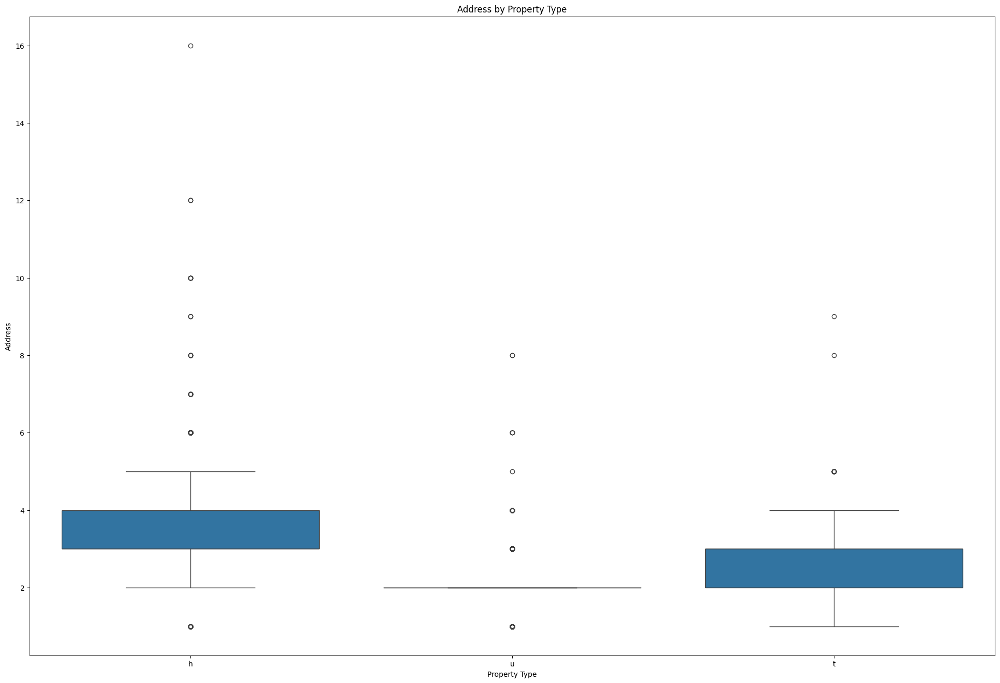

In [54]:
plt.figure(figsize=(24, 16))
sns.boxplot(x='Type', y='Rooms', data=df)
plt.title("Address by Property Type")
plt.xlabel("Property Type")
plt.ylabel("Address")
plt.show()